In [1]:
# -*- coding: utf-8 -*-
"""
Created on Wed Oct  2 15:25:11 2019

@author: Paul W.
"""
# =============================================================================
#### Initialysing
# =============================================================================


'\nCreated on Wed Oct  2 15:25:11 2019\n\n@author: Paul W.\n'

In [2]:
## Load toolkits
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [3]:
# Load scalers
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import Normalizer

In [4]:
# Load estimators (Regression & Classification)
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn import svm

from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier

import os
os.environ['KMP_DUPLICATE_LIB_OK']='True'
from xgboost import XGBRegressor
from xgboost import XGBClassifier

In [5]:
# Load performance metrics
from math import sqrt
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import max_error
from sklearn.metrics import explained_variance_score

from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import cohen_kappa_score

In [6]:
# Visualization
import plotly.express as px
from plotly.offline import plot

In [7]:
# Resampling
from sklearn.utils.random import sample_without_replacement

In [8]:
## Set path
my_path = os.path.abspath(os.path.dirname('__file__'))
parentDir = os.path.dirname(my_path) 
DataDir = os.path.join(parentDir, 'Raw_data')
SubmissionDir = os.path.join(parentDir, 'Submission')

In [9]:
## Set file names
filename_train = os.path.abspath(os.path.join(DataDir, 'trainingData.csv'))
filename_val = os.path.abspath(os.path.join(DataDir, 'validationData.csv'))

In [10]:
## Load data
wifi_train_raw = pd.read_csv(filename_train)
wifi_val_raw = pd.read_csv(filename_val)

In [11]:
# =============================================================================
#### Data preparation  
# =============================================================================

In [12]:
## 1. Transformation of RSSI
wifi_train = wifi_train_raw.copy()
wifi_val = wifi_val_raw.copy()

#### Ignacio: Paul, you should mention why you perform this transformation ie (adding 105 and replacing 205 by 0) 

wifi_train.iloc[:, :520] = pd.DataFrame(wifi_train.iloc[:, :520] + 105).replace(to_replace = 205, value = 0)
wifi_val.iloc[:, :520] = pd.DataFrame(wifi_val.iloc[:, :520] + 105).replace(to_replace = 205, value = 0)

In [13]:
## 2. Transformation of 3D-Space (Rotation around z-axis)
# Find angle
#### Ignacio: The angle to search is the one to rotate the z-axis is such a way that all the buildings have rougly the same
#### minimum latitude. This, will help a lot to determine the building with methods like SVM, DT or RF  ONLY IF you have a prediction
#### for the LONGITUDE and LATITUDE as long as the predicted values for each building doesn't mix. You can only rotate the predictions.

pi_deg = np.arctan((wifi_train['LATITUDE'].max() - wifi_train['LATITUDE'].min())/
                   (abs(wifi_train['LONGITUDE'].min()) - abs(wifi_train['LONGITUDE'].max())))*180/np.pi


In [14]:
pi_deg

34.75295449825902

In [15]:
# Set angle
#### Ignacio: Why theta is != pi_deg ;)
theta = np.radians(27.5)

In [16]:
# Define transformation matrix
#### Ignacio: This is the rotation matrix of SO(3)

tM = np.matrix([[np.cos(theta), -np.sin(theta), 0],
                [np.sin(theta), np.cos(theta), 0],
                [0, 0, 1]])

In [17]:
# Select coordination columns

v_train = np.matrix(wifi_train[['LONGITUDE', 'LATITUDE', 'FLOOR']])
v_train.shape
v_train =  np.transpose(v_train)

type(tM)
type(v_train)

v_val = np.matrix(wifi_val_raw[['LONGITUDE', 'LATITUDE', 'FLOOR']])
v_val.shape
v_val = np.transpose(v_val)

In [18]:
# Transform coordination

tMv_train = tM * v_train
tMv_val = tM * v_val

type(tMv_train)

wifi_train[['LONGITUDE', 'LATITUDE', 'FLOOR']] = np.transpose(tMv_train)
wifi_val[['LONGITUDE', 'LATITUDE', 'FLOOR']] = np.transpose(tMv_val)

In [19]:
## 3. Change scales
# LONGITUDE
#### Ignacio: Why do you add this particular ammount to the values? It should be explained

wifi_train.iloc[:, 520] = wifi_train.iloc[:, 520] + 2253200
wifi_val.iloc[:, 520] = wifi_val.iloc[:, 520] + 2253200

In [20]:
# LATITUDE
#### Ignacio: Why do you substract this particular ammount to the values? It should be explained
wifi_train.iloc[:, 521] = wifi_train.iloc[:, 521] - 4311690
wifi_val.iloc[:, 521] = wifi_val.iloc[:, 521] - 4311690

In [21]:
#### Ignacio: This line is needed in order to prevent plots opening uin a separate window.
%matplotlib inline

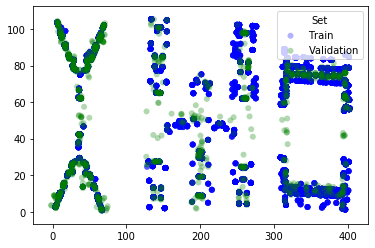

In [22]:
#### Ignacio: You should consider adding a legend to explain to which dataset corrresponds each set of points.
#plt.scatter(wifi_train.iloc[:, 520] , wifi_train.iloc[:, 521])
#plt.scatter(wifi_val.iloc[:, 520] , wifi_val.iloc[:, 521])

fig, ax = plt.subplots()

# Train set
x_train = wifi_train.iloc[:, 520]
y_train = wifi_train.iloc[:, 521]

# Validation set
x_val = wifi_val.iloc[:, 520]
y_val = wifi_val.iloc[:, 521]

ax.scatter(x_train, y_train, c='blue', label='Train',
               alpha=0.3, edgecolors='none')

ax.scatter(x_val, y_val, c='green', label='Validation',
               alpha=0.3, edgecolors='none')

legend = ax.legend(loc="upper right", title="Set")

plt.show()


In [23]:
# =============================================================================
#### Data exploration
# =============================================================================

## 3D Scatterplot of raw training data
fig_raw = px.scatter_3d(wifi_train_raw, x='LONGITUDE', y='LATITUDE', z='FLOOR',
                        color = 'BUILDINGID', size_max = 5, opacity = 0.7)
fig_raw.update_layout(margin=dict(l=0, r=0, b=0, t=0))
plot(fig_raw)

'temp-plot.html'

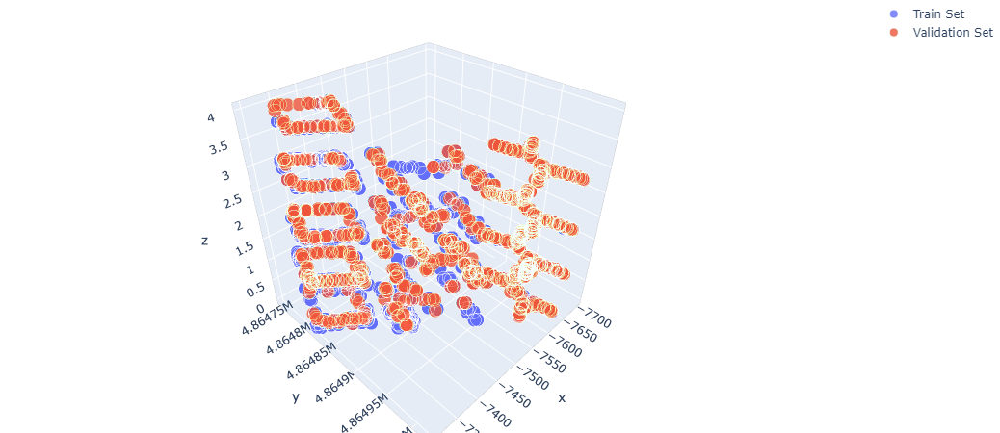

In [27]:
import chart_studio.plotly as py
import plotly.graph_objects as go
import plotly.io as pio

Train = go.Scatter3d(
    x=wifi_train_raw['LONGITUDE'],
    y=wifi_train_raw['LATITUDE'],
    z=wifi_train_raw['FLOOR'],
    name="Train Set",
    mode='markers',
    marker=dict(
        size=8,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

Validation = go.Scatter3d(
    x=wifi_val_raw['LONGITUDE'],
    y=wifi_val_raw['LATITUDE'],
    z=wifi_val_raw['FLOOR'],
    name="Validation Set",
    mode='markers',
    marker=dict(
        size=8,
        line=dict(
            color='rgba(36,209,140,0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

data = [Train, Validation]

layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    )
)

fig = go.Figure(data=data, layout=layout)
pio.show(fig)

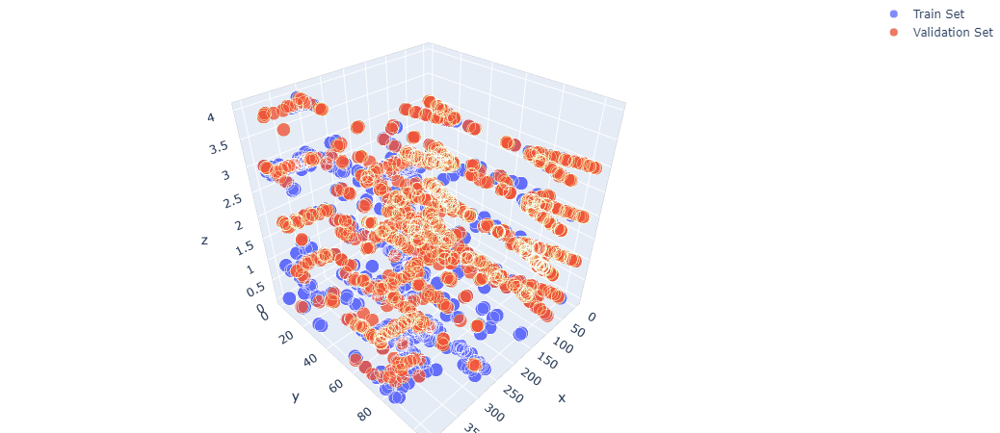

In [28]:
Train = go.Scatter3d(
    x=wifi_train['LONGITUDE'],
    y=wifi_train['LATITUDE'],
    z=wifi_train['FLOOR'],
    name="Train Set",
    mode='markers',
    marker=dict(
        size=8,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

Validation = go.Scatter3d(
    x=wifi_val['LONGITUDE'],
    y=wifi_val['LATITUDE'],
    z=wifi_val['FLOOR'],
    name="Validation Set",
    mode='markers',
    marker=dict(
        size=8,
        line=dict(
            color='rgba(36,209,140,0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)

data = [Train, Validation]

layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    )
)

fig = go.Figure(data=data, layout=layout)
pio.show(fig)

In [29]:
## Histogram: Frequency of RSSI signal strength over all WAPs
# Change to merged format

WAPsmelted_train = pd.melt(wifi_train.filter(like = "WAP"))
WAPsmelted_wo100_train = WAPsmelted_train.loc[(WAPsmelted_train.iloc[:,1] != 0)]

WAPsmelted_val = pd.melt(wifi_val.filter(like = "WAP"))
WAPsmelted_wo100_Val = WAPsmelted_val.loc[(WAPsmelted_val.iloc[:,1] != 0)]

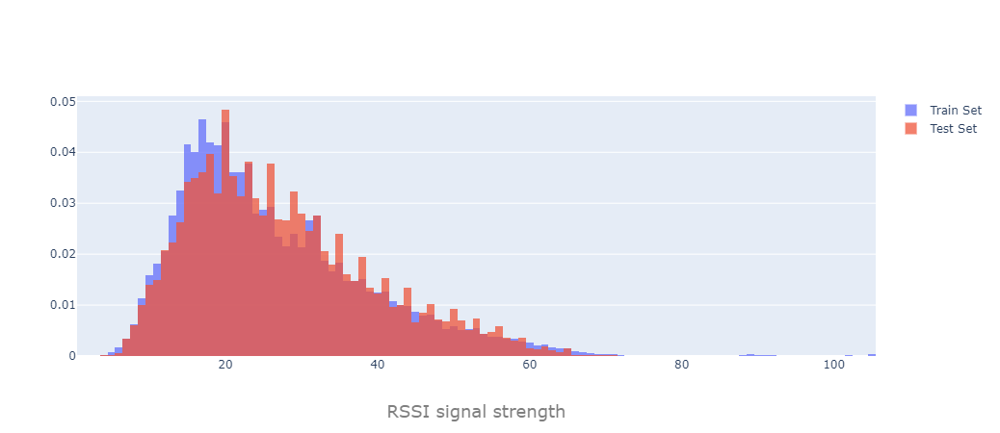

In [30]:
fig = go.Figure()

fig.add_trace(go.Histogram(x=WAPsmelted_wo100_train['value'],histnorm='probability',name="Train Set"))
fig.add_trace(go.Histogram(x=WAPsmelted_wo100_Val['value'],histnorm='probability',name="Test Set"))

# Overlay both histograms
fig.update_layout(barmode='overlay',
                  xaxis=go.layout.XAxis(
                    title=go.layout.xaxis.Title(
                    text="RSSI signal strength",
                    font=dict(
                         size=18,
                         color="#7f7f7f"
                        )
                    )
     )
                 )
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.show()

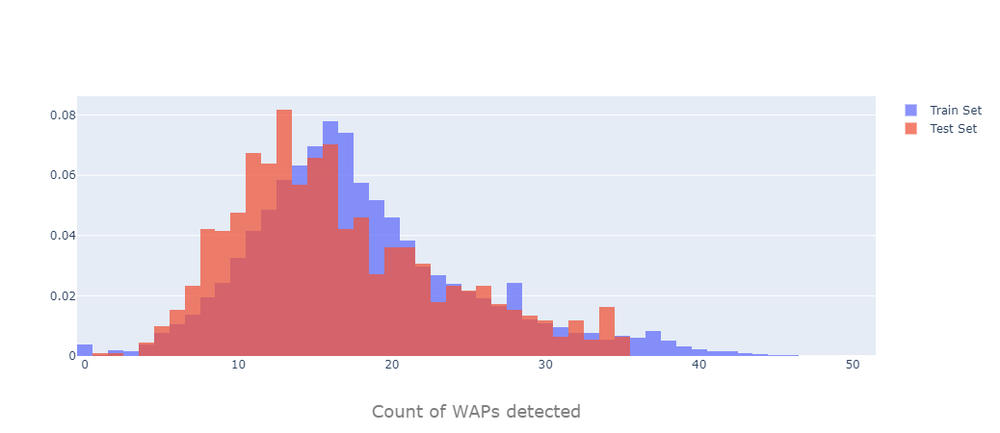

In [31]:
fig = go.Figure()

fig.add_trace(go.Histogram(x=wifi_train.iloc[:,0:520].gt(0).sum(axis=1),histnorm='probability',name="Train Set"))
fig.add_trace(go.Histogram(x=wifi_val.iloc[:,0:520].gt(0).sum(axis=1),histnorm='probability',name="Test Set"))

# Overlay both histograms
fig.update_layout(barmode='overlay',
                 xaxis=go.layout.XAxis(
                    title=go.layout.xaxis.Title(
                    text="Count of WAPs detected",
                    font=dict(
                         size=18,
                         color="#7f7f7f"
                        )
                    )
     )
                 )
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.show()

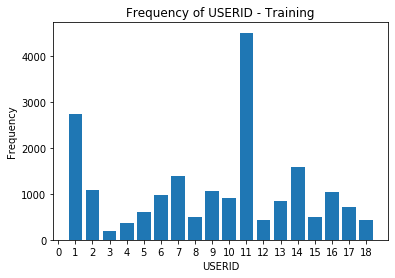

In [32]:
## BAR - USERID

bar = plt.figure(2)
plt.bar(x = wifi_train['USERID'].value_counts().index, height = wifi_train['USERID'].value_counts())
plt.xticks(list(range(0,19)))
plt.title('Frequency of USERID - Training')
plt.xlabel('USERID')
plt.ylabel('Frequency')
plt.interactive(False)
plt.show()

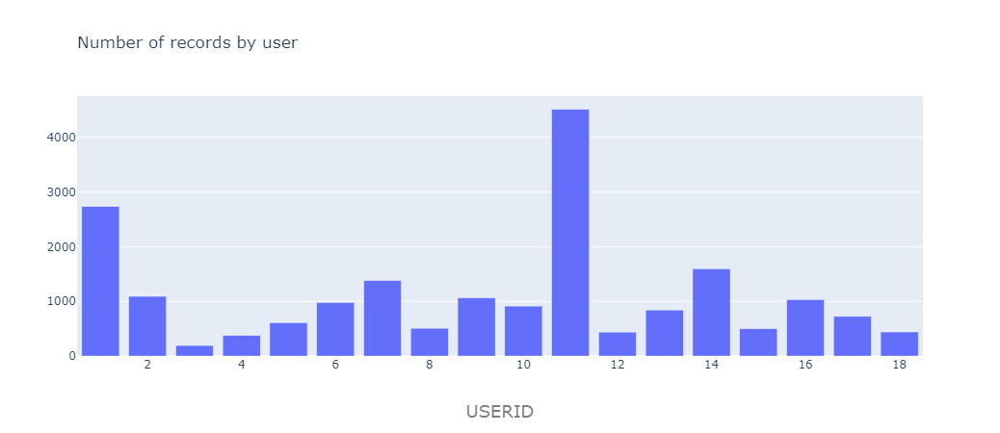

In [33]:
fig = go.Figure([go.Bar(x=wifi_train['USERID'].value_counts().index, y=wifi_train['USERID'].value_counts())])
fig.update_layout(barmode='overlay',
                  title=go.layout.Title(
                  text="Number of records by user",
                  xref="paper",
                  x=0
                  ),
                 xaxis=go.layout.XAxis(
                    title=go.layout.xaxis.Title(
                    text="USERID",
                    font=dict(
                         size=18,
                         color="#7f7f7f"
                        )
                    )
     )
                 )
fig.show()

Text(0, 0.5, 'Frequency')

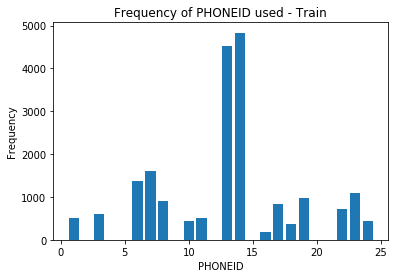

In [35]:
# Create subplot of histograms - training

x = wifi_train['PHONEID'].value_counts().reset_index()
plt.bar(x = x['index'], height = x.loc[:,'PHONEID'])
plt.title('Frequency of PHONEID used - Train')
plt.xlabel('PHONEID')
plt.ylabel('Frequency')
#draw_histograms(wifi_train, 4, 4)

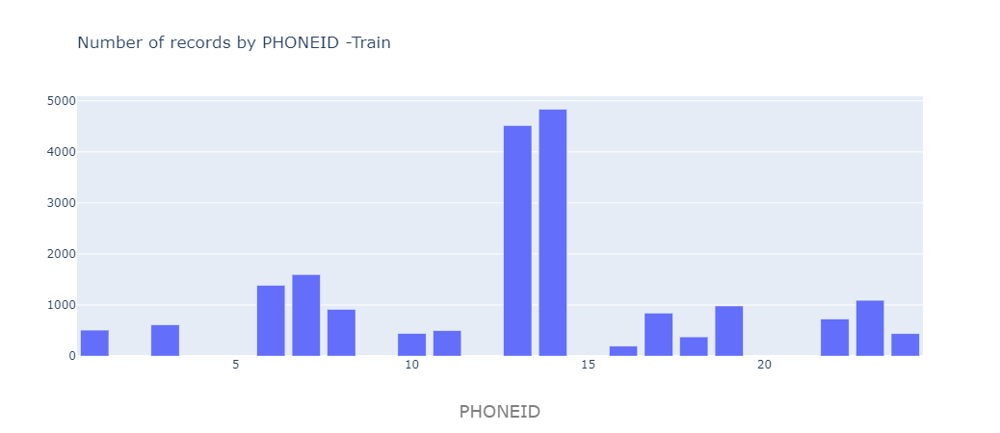

In [36]:
# Create subplot of histograms - training

x = wifi_train['PHONEID'].value_counts().reset_index()

fig = go.Figure([go.Bar(x=x['index'], y=x.loc[:,'PHONEID'])])
fig.update_layout(barmode='overlay',
                  title=go.layout.Title(
                  text="Number of records by PHONEID -Train",
                  xref="paper",
                  x=0
                  ),
                 xaxis=go.layout.XAxis(
                    title=go.layout.xaxis.Title(
                    text="PHONEID",
                    font=dict(
                         size=18,
                         color="#7f7f7f"
                        )
                    )
     )
                 )
fig.show()

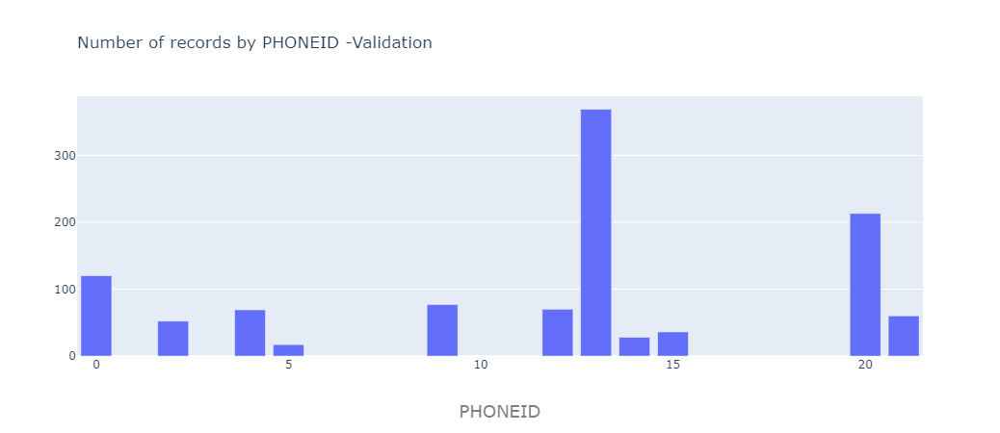

In [37]:
x = wifi_val['PHONEID'].value_counts().reset_index()

fig = go.Figure([go.Bar(x=x['index'], y=x.loc[:,'PHONEID'])])
fig.update_layout(barmode='overlay',
                  title=go.layout.Title(
                  text="Number of records by PHONEID -Validation",
                  xref="paper",
                  x=0
                  ),
                 xaxis=go.layout.XAxis(
                    title=go.layout.xaxis.Title(
                    text="PHONEID",
                    font=dict(
                         size=18,
                         color="#7f7f7f"
                        )
                    )
     )
                 )
fig.show()

In [38]:
# =============================================================================
#### Pre-processing
# =============================================================================

In [39]:
### Identify all unique ref. points in train
####Ignacio: It should be explained why this needs to be done.
wifi_train_groups = wifi_train.copy()

In [40]:
# Round LONG./LAT. to meters
#### Ignacio: Why? How do you know the units? Please add a reference to the dataset info.

d = 0
wifi_train_groups['LONGITUDE'] = round(wifi_train_groups['LONGITUDE'], d)
wifi_train_groups['LATITUDE'] = round(wifi_train_groups['LATITUDE'], d)

In [41]:
# Dicover all unique reference points (refP)

grouping_train = wifi_train_groups.groupby(['FLOOR', 'LONGITUDE', 'LATITUDE'])

In [42]:
# Store unique refPs and create identifier

wifi_train_refP = grouping_train.size().reset_index().rename(columns={0:'count'})
wifi_train_refP['index'] = list(range(0, 926))
wifi_train_refP['setID'] = 'train'
wifi_train_refP['REFPOINTID'] = list(range(0, 926))
wifi_train_refP.head()

,FLOOR,LONGITUDE,LATITUDE,count,index,setID,REFPOINTID
0,0.0,8.0,7.0,20,0,train,0
1,0.0,8.0,9.0,20,1,train,1
2,0.0,10.0,10.0,20,2,train,2
3,0.0,10.0,99.0,20,3,train,3
4,0.0,11.0,97.0,20,4,train,4


In [43]:
### Identify all unique (rounded) refP in val

wifi_val_groups = wifi_val.copy()

In [44]:
# Round LONG./LAT. to meters and create identifier

wifi_val_groups['LONGITUDE'] = round(wifi_val_groups['LONGITUDE'], d)
wifi_val_groups['LATITUDE'] = round(wifi_val_groups['LATITUDE'], d)
wifi_val_groups['index'] = wifi_val_groups.index
wifi_val_groups['setID'] = 'val'
wifi_val_groups.head()

,WAP001,WAP002,WAP003,WAP004,WAP005,WAP006,WAP007,WAP008,WAP009,WAP010,...,LATITUDE,FLOOR,BUILDINGID,SPACEID,RELATIVEPOSITION,USERID,PHONEID,TIMESTAMP,index,setID
0,0,0,0,0,0,0,0,0,0,0,...,49.0,1.0,1,0,0,0,0,1380872703,0,val
1,0,0,0,0,0,0,0,0,0,0,...,66.0,4.0,2,0,0,0,13,1381155054,1,val
2,0,0,0,0,0,0,0,0,0,0,...,77.0,4.0,2,0,0,0,13,1381155095,2,val
3,0,0,0,0,0,0,0,0,0,0,...,77.0,4.0,2,0,0,0,13,1381155138,3,val
4,0,0,0,0,0,0,0,0,0,0,...,20.0,2.0,0,0,0,0,2,1380877774,4,val


In [45]:
# Identify redundant data (which is in train and val)

wifi_grouped_inner = pd.merge(wifi_train_refP, wifi_val_groups[['FLOOR', 'LONGITUDE', 'LATITUDE', 'index', 'setID']], 
                              how = 'inner', left_on=['FLOOR', 'LONGITUDE', 'LATITUDE'], 
                              right_on = ['FLOOR', 'LONGITUDE', 'LATITUDE'])

In [46]:
wifi_grouped_inner.head()

,FLOOR,LONGITUDE,LATITUDE,count,index_x,setID_x,REFPOINTID,index_y,setID_y
0,0.0,8.0,7.0,20,0,train,0,621,val
1,0.0,8.0,9.0,20,1,train,1,63,val
2,0.0,10.0,10.0,20,2,train,2,64,val
3,0.0,16.0,14.0,20,10,train,10,657,val
4,0.0,16.0,91.0,29,11,train,11,109,val


In [47]:
# Seperate redundant val data

val_4_train = wifi_val_groups.loc[~wifi_val_groups['index'].isin(wifi_grouped_inner['index_y'])]         # 859 rows
val_4_val = wifi_val_groups.loc[wifi_val_groups['index'].isin(wifi_grouped_inner['index_y'])]            # 252 rows

In [48]:
# Create new validation

wifi_val_add = wifi_train.loc[:, :'TIMESTAMP'].sample(1750, replace = False, random_state = 123)
wifi_val_new = pd.concat([wifi_val_add, val_4_val.loc[:, :'TIMESTAMP']], axis = 0)  ## 1750 + 252

In [49]:
# wifi_train_new: 19937 - 1750 (wifi_val_add) + 859 (val_4_train) = 19046

wifi_train_new = pd.concat([wifi_train.loc[~wifi_train.index.isin(wifi_val_add.index), :'TIMESTAMP'], 
                            val_4_train.loc[:, :'TIMESTAMP']], axis = 0)

In [50]:
### Address duplicated/empty rows and empty columns

In [51]:
## Duplicated rows
# Identify rows

duplicates_train = wifi_train_new.loc[wifi_train_new.duplicated(subset=None, keep='first') == True,:]  
duplicates_val = wifi_val_new.loc[wifi_val_new.duplicated(subset=None, keep='first') == True,:]        
len(duplicates_train)                       #571 duplicated rows in train
len(duplicates_val)                         #15 duplicated rows in validation

15

In [52]:
# Remove rows

wifi_train_new = wifi_train_new.drop_duplicates(subset=None, keep='first', inplace=False)
wifi_val_new = wifi_val_new.drop_duplicates(subset=None, keep='first', inplace=False)
len(wifi_train_new)                                               # 18475 rows

18475

In [53]:
## Empty columns (undetected WAPs) in train
# Identify empty columns

duplicates_col_train = pd.DataFrame(wifi_train_new.sum(axis = 0) == 0)
duplicates_col_train.columns = ['duplicates']
duplicates_col_train = duplicates_col_train.loc[duplicates_col_train['duplicates'] == True]
len(duplicates_col_train.index)                                   # 8 empty columns

8

In [54]:
## Find undetected WAPs in validation set

duplicates_col_val = pd.DataFrame(wifi_val_new.sum(axis = 0) == 0)
duplicates_col_val.columns = ['duplicates']
duplicates_col_val = duplicates_col_val.loc[duplicates_col_val['duplicates'] == True]
len(duplicates_col_val.index)    

72

In [55]:
## Drop 8 WAPs not detected in train_new

wifi_train_unique512 = wifi_train_new.drop(columns=duplicates_col_train.index)
wifi_val_unique512 = wifi_val_new.drop(columns=duplicates_col_train.index)      #Drop same columns in validation set

In [56]:
# Check

wifi_train_new.shape[1] - wifi_train_unique512.shape[1]           # 8 dropped
(wifi_train_unique512.sum(axis = 0) == 0).value_counts()          # False = 521; No True anymore
(wifi_val_unique512.sum(axis = 0) == 0).value_counts()            # False = 449; True = 72; --> still 72 in validation

False    449
True      72
dtype: int64

In [57]:
## Empty rows (w/o WAP detection)
# Discover rows with zero WAPs detected

WAPs_det = wifi_train_unique512.filter(like = 'WAP').gt(0).sum(axis = 1)
#plt.hist(WAPs_det, bins = 512)

fig = go.Figure()

fig.add_trace(go.Histogram(x=WAPS_det,histnorm='probability',name="Train Set"))

# Set Layout
fig.update_layout(barmode='overlay',
                 xaxis=go.layout.XAxis(
                    title=go.layout.xaxis.Title(
                    text="Count of WAPs detected",
                    font=dict(
                         size=18,
                         color="#7f7f7f"
                        )
                    )
     )
                 )
# Reduce opacity to see both histograms

fig.show()

NameError: name 'WAPS_det' is not defined

In [58]:
zero_WAPs_det_id = WAPs_det.loc[WAPs_det == 0].index           
len(zero_WAPs_det_id)                                             # 70 rows with 0 WAPs detected

70

In [59]:
WAPs_det_val = wifi_val_unique512.filter(like = 'WAP').gt(0).sum(axis = 1)
zero_WAPs_det_id_val = WAPs_det_val.loc[WAPs_det_val == 0].index  # 4 rows with 0 WAPs detected

In [60]:
# Drop rows with zero WAPs detected

wifi_train_unique  = wifi_train_unique512.drop(index = zero_WAPs_det_id) 
wifi_val_unique  = wifi_val_unique512.drop(index = zero_WAPs_det_id_val) 

In [61]:
### Set data types
#### Ignacio: This steps should be done at the very beggining of the script, after getting a summary of the df
#### with .describe(), count_values().

In [62]:
## train

wifi_train_unique.dtypes
wifi_train_unique['FLOOR'] = wifi_train_unique['FLOOR'].astype('category')
wifi_train_unique['BUILDINGID'] = wifi_train_unique['BUILDINGID'].astype('category')
wifi_train_unique['SPACEID'] = wifi_train_unique['SPACEID'].astype('category')
wifi_train_unique['RELATIVEPOSITION'] = wifi_train_unique['RELATIVEPOSITION'].astype('category')
wifi_train_unique['USERID'] = wifi_train_unique['USERID'].astype('category')
wifi_train_unique['PHONEID'] = wifi_train_unique['PHONEID'].astype('category')

C:\Users\Ignacio\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\Ignacio\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\Ignacio\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

In [63]:
## Val

wifi_val_unique.dtypes
wifi_val_unique['FLOOR'] = wifi_val_unique['FLOOR'].astype('category')
wifi_val_unique['BUILDINGID'] = wifi_val_unique['BUILDINGID'].astype('category')
wifi_val_unique['SPACEID'] = wifi_val_unique['SPACEID'].astype('category')
wifi_val_unique['RELATIVEPOSITION'] = wifi_val_unique['RELATIVEPOSITION'].astype('category')
wifi_val_unique['USERID'] = wifi_val_unique['USERID'].astype('category')
wifi_val_unique['PHONEID'] = wifi_val_unique['PHONEID'].astype('category')

C:\Users\Ignacio\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\Ignacio\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\Users\Ignacio\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.htm

In [64]:
### Data splitting

In [65]:
## Training set
# Features (X_train)

X_train = wifi_train_unique.filter(like = 'WAP', axis = 1)

In [66]:
# Dependent Variable Training Set (y Training)

y_train_long = wifi_train_unique['LONGITUDE']
y_train_lat = wifi_train_unique['LATITUDE']
y_train_floor = wifi_train_unique['FLOOR']
y_train_building = wifi_train_unique['BUILDINGID']
y_train_long_count = len(y_train_long.index)
print('The number of observations in the Y training set are:',str(y_train_long_count))


The number of observations in the Y training set are: 18403


In [67]:
## Testing Set
# Features (X_val)

X_val = wifi_val_unique.loc[:, X_train.columns]
X_val_count = len(X_val.index)
print('The number of observations in the feature testing set is:',str(X_val_count))

The number of observations in the feature testing set is: 1983


In [68]:
# Ground Truth (y_val) 

y_val_long = wifi_val_unique['LONGITUDE']
y_val_lat = wifi_val_unique['LATITUDE']
y_val_floor = wifi_val_unique['FLOOR']
y_val_building = wifi_val_unique['BUILDINGID']
y_val_long_count = len(y_val_long.index)
print('The number of observations in the Y training set are:', str(y_val_long_count))

The number of observations in the Y training set are: 1983


In [69]:
### Scaling

In [70]:
## Normalize rows
# Train

scaler_normObs = Normalizer(norm = 'l2', copy = True)
X_train_normObs = scaler_normObs.fit_transform(X_train)
X_train_normObs = pd.DataFrame(X_train_normObs, index = X_train.index, columns = X_train.columns)

In [71]:
# Val

X_val_normObs = scaler_normObs.transform(X_val)
X_val_normObs = pd.DataFrame(X_val_normObs, index = X_val.index, columns = X_val.columns)

In [72]:
# =============================================================================
#### Modelling
# =============================================================================

In [73]:
### Building
## Define models

modelkNN_build = KNeighborsClassifier()
modelRF_build = RandomForestClassifier()

In [74]:
## Fit models

modelkNN_build.fit(X_train_normObs, y_train_building) 
modelRF_build.fit(X_train_normObs, y = y_train_building)

C:\Users\Ignacio\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.



RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=10,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [75]:
## Make predictions

pred_build_kNN = modelkNN_build.predict(X_val_normObs)
pred_build_RF = modelkNN_build.predict(X_val_normObs)

In [76]:
## Calculate performance metrics accuracy and kappa
# Class report

acc_kNN = classification_report(y_val_building, pred_build_kNN, labels = [0, 1, 2])   
acc_RF = classification_report(y_val_building, pred_build_RF, labels = [0, 1, 2])
#### Ignacio, pleas add some descriptive info about what you report.

print("Results of K-NN model in predicting building: ")
print(acc_kNN)
print("Results of RF   model in predicting building: ")
print(acc_RF)

Results of K-NN model in predicting building: 
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       596
           1       1.00      1.00      1.00       531
           2       1.00      1.00      1.00       856

    accuracy                           1.00      1983
   macro avg       1.00      1.00      1.00      1983
weighted avg       1.00      1.00      1.00      1983

Results of RF   model in predicting building: 
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       596
           1       1.00      1.00      1.00       531
           2       1.00      1.00      1.00       856

    accuracy                           1.00      1983
   macro avg       1.00      1.00      1.00      1983
weighted avg       1.00      1.00      1.00      1983



In [77]:
# Accuracy & Kappa

print("Accuracy and Kappa values from the k-NN model results:")
print(accuracy_score(y_val_building, pred_build_kNN), cohen_kappa_score(y_val_building, pred_build_kNN))
print("Accuracy and Kappa values from the RF   model results:")
print(accuracy_score(y_val_building, pred_build_RF), cohen_kappa_score(y_val_building, pred_build_RF))

Accuracy and Kappa values from the k-NN model results:
0.9994957135653051 0.9992262070370285
Accuracy and Kappa values from the RF   model results:
0.9994957135653051 0.9992262070370285


In [78]:
## Concat X_train and prediction for building

X_train_normObs_casc = pd.concat([X_train_normObs, y_train_building], axis = 1)
X_val_normObs_casc = pd.concat([X_val_normObs, y_val_building], axis = 1)

In [79]:
### LONGITUDE, LATITUDE and FLOOR

In [80]:
## Define models

#### Ignacio: Why do you fix beforehand the number of neigbourhs for the k-NN model?
#### Did you made a benchmark before determining the best value? If so, you should report it 
#### and add a plot of performace as function of k.
#### If it's just a matter of computational efficiency, then you should justify it also reporting
#### a time benchmark.
#### On the same time, you should justify the need of weigths by distance.

modelkNN_long = KNeighborsRegressor(n_neighbors=7, weights='distance')
modelRF_long = RandomForestRegressor()

modelkNN_lat = KNeighborsRegressor(n_neighbors=2, weights='distance')
modelRF_lat = RandomForestRegressor()

modelkNN_floor = KNeighborsClassifier(n_neighbors=2, weights='distance')
modelRF_floor = RandomForestClassifier()

In [81]:
## Fit models

modelkNN_long.fit(X_train_normObs_casc, y_train_long)
modelRF_long.fit(X_train_normObs_casc, y_train_long)

modelkNN_lat.fit(X_train_normObs_casc, y_train_lat)
modelRF_lat.fit(X_train_normObs_casc, y_train_lat)

modelkNN_floor.fit(X_train_normObs_casc, y_train_floor)
modelRF_floor.fit(X_train_normObs_casc, y_train_floor)

C:\Users\Ignacio\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

C:\Users\Ignacio\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

C:\Users\Ignacio\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.



RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=10,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [82]:
## Make predictions

pred_long_kNN = modelkNN_long.predict(X_val_normObs_casc)
pred_long_RF = modelRF_long.predict(X_val_normObs_casc)

pred_lat_kNN = modelkNN_lat.predict(X_val_normObs_casc)
pred_lat_RF  = modelRF_lat.predict(X_val_normObs_casc)

pred_floor_kNN = modelkNN_floor.predict(X_val_normObs_casc)
pred_floor_RF = modelRF_floor.predict(X_val_normObs_casc)

In [83]:
### Calculation of Performance metrics

## LONG & LAT
####Ignacio: EXCELLENT idea!!!
# Define function
def performance(predictions_long, predictions_lat, y_val_long, y_val_lat):
    
    longlat = {'Rsq': [r2_score(y_val_long, predictions_long), r2_score(y_val_lat, predictions_lat)], 
               'RMSE': [sqrt(mean_squared_error(y_val_long, predictions_long)), sqrt(mean_squared_error(y_val_lat, predictions_lat))], 
               'MAE': [mean_absolute_error(y_val_long, predictions_long), mean_absolute_error(y_val_lat, predictions_lat)], 
               'Emax': [max_error(y_val_long, predictions_long), max_error(y_val_lat, predictions_lat)]}
    
    perf_model = pd.DataFrame(longlat)
    return perf_model

In [84]:
# Calculate metrics - kNN

#### Ignacio: This line has a terrible mistake!!! You are using YOUR OWN function incorrectly!!!
#### You create your own function and you use it incorrectly!

#perf_kNN = performance(pred_long_kNN, pred_long_RF, y_val_long, y_val_long)
#newcolumns = pd.DataFrame({'Var': ['long', 'long'], 'Alg': ['kNN', 'RF']})
#perf_kNN = pd.concat([perf_kNN, newcolumns], axis = 1)

perf_kNN = performance(pred_long_kNN, pred_lat_kNN, y_val_long, y_val_lat)
newcolumns = pd.DataFrame({'Var': ['long', 'lat'], 'Alg': ['kNN', 'kNN']})
perf_kNN = pd.concat([perf_kNN, newcolumns], axis = 1)
perf_kNN.head()

,Rsq,RMSE,MAE,Emax,Var,Alg
0,0.999011,4.388533,2.201810,63.436891,long,kNN
1,0.986724,3.643171,1.460463,42.261874,lat,kNN


In [85]:
# Calculate metrics - RF

#### Ignacio: Same as before!! If you want the output arranged in a different way, you should recode your function accordingly.

#perf_LR = performance(pred_lat_kNN, pred_lat_RF, y_val_lat, y_val_lat)
#newcolumns = pd.DataFrame({'Var': ['lat', 'lat'], 'Alg': ['kNN', 'RF']})
#perf_LR = pd.concat([perf_LR, newcolumns], axis = 1)

perf_RF = performance(pred_long_RF, pred_lat_RF, y_val_long, y_val_lat)
newcolumns = pd.DataFrame({'Var': ['lon', 'lat'], 'Alg': ['RF', 'RF']})
perf_RF = pd.concat([perf_RF, newcolumns], axis = 1)
perf_RF.head()

,Rsq,RMSE,MAE,Emax,Var,Alg
0,0.998498,5.408238,2.879623,69.068621,lon,RF
1,0.981984,4.244036,2.347878,39.675437,lat,RF


In [86]:
perf_longlat = pd.concat([perf_kNN, perf_RF], axis = 0)
perf_longlat.head()

,Rsq,RMSE,MAE,Emax,Var,Alg
0,0.999011,4.388533,2.201810,63.436891,long,kNN
1,0.986724,3.643171,1.460463,42.261874,lat,kNN
0,0.998498,5.408238,2.879623,69.068621,lon,RF
1,0.981984,4.244036,2.347878,39.675437,lat,RF


In [87]:
# Calculate accuracy - Floor

acc_kNN_floor = classification_report(y_val_floor, pred_floor_kNN, labels = [0, 1, 2, 3, 4])     
acc_RF_floor = classification_report(y_val_floor, pred_floor_RF, labels = [0, 1, 2, 3, 4])   

print("Results from the kNN model in predicting floor: ")
print(acc_kNN_floor)

print("Results from the RF model in predicting floor: ")
print(acc_RF_floor)

print("Accuracy and Kappa values from the k-NN model results in predicting floor:")
print(accuracy_score(y_val_floor, pred_floor_kNN), cohen_kappa_score(y_val_floor, pred_floor_kNN))

print("Accuracy and Kappa values from the RF model results in predicting floor:")
print(accuracy_score(y_val_floor, pred_floor_RF), cohen_kappa_score(y_val_floor, pred_floor_RF))

Results from the kNN model in predicting floor: 
              precision    recall  f1-score   support

           0       0.99      1.00      1.00       424
           1       1.00      0.99      0.99       565
           2       0.99      1.00      0.99       466
           3       1.00      0.99      0.99       433
           4       0.99      0.99      0.99        95

    accuracy                           0.99      1983
   macro avg       0.99      0.99      0.99      1983
weighted avg       0.99      0.99      0.99      1983

Results from the RF model in predicting floor: 
              precision    recall  f1-score   support

           0       0.99      1.00      0.99       424
           1       0.99      0.99      0.99       565
           2       0.99      0.99      0.99       466
           3       1.00      0.99      0.99       433
           4       0.99      0.99      0.99        95

    accuracy                           0.99      1983
   macro avg       0.99      0.99 

In [88]:
#### Ignacio: Paul, all of this are error metrics ie. NUMBERS!!! NUMBERS doesn't tell you where your model
#### is making mistakes!!! They are just a summary. Did you did the "mushroom challenge"?
#### Why you didn't plot the errors of your models in order to inspect where and why each model fails and to
#### provide insigth in how to improve them? Where your models are making smaller and bigger errors?
####Why you didn't plot the confussion matrix?

In [89]:
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels

def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    classes = classes[unique_labels(y_true, y_pred)]
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax


Confusion matrix, without normalization
[[596   0   0]
 [  0 531   0]
 [  0   1 855]]
Confusion matrix, without normalization
[[596   0   0]
 [  0 531   0]
 [  0   1 855]]


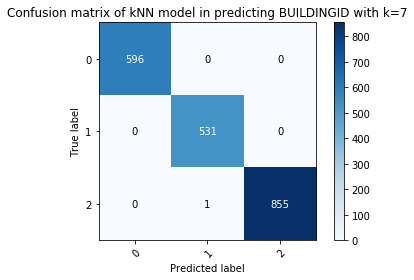

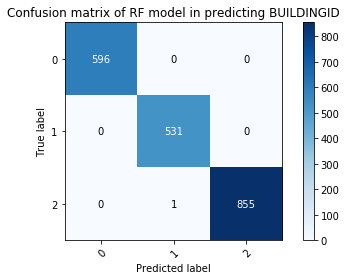

In [90]:
# Plot non-normalized confusion matrix

#y_val_building, pred_build_kNN
plot_confusion_matrix(y_val_building, pred_build_kNN, classes=np.array([0,1,2]),
                      normalize=False,
                      title='Confusion matrix of kNN model in predicting BUILDINGID with k=7')

#y_val_building, pred_build_kNN
plot_confusion_matrix(y_val_building, pred_build_RF, classes=np.array([0,1,2]),
                      normalize=False,
                      title='Confusion matrix of RF model in predicting BUILDINGID')


In [110]:
# Creating a df with information about the errors on longitude and latitude for the kNN and RF models.

kNN_errors = pd.DataFrame({'e_lon': y_val_long-pred_long_kNN ,
                           '|e_lon|': abs(pred_long_kNN-y_val_long),
                           'e_lat': y_val_lat-pred_lat_kNN,
                           '|e_lat|': abs(pred_lat_kNN-y_val_lat),
                           'e1_tot': abs(pred_long_kNN-y_val_long) + abs(pred_lat_kNN-y_val_lat),
                           'e2_lon': np.power(pred_long_kNN-y_val_long,2),
                           'e2_lat': np.power(pred_lat_kNN-y_val_lat,2),
                            'e2_tot': np.sqrt(np.power(pred_long_kNN-y_val_long,2)+np.power(pred_lat_kNN-y_val_lat,2))})
#kNN_errors['Type'] = pd.cut(k_NN_errors['e1_tot'],)
print("kNN results")
print(kNN_errors.head())
print()
print(kNN_errors.describe())
print("================")

RF_errors = pd.DataFrame({'e_lon': y_val_long-pred_long_RF ,
                           '|e_lon|': abs(pred_long_RF-y_val_long),
                           'e_lat': y_val_lat-pred_lat_RF,
                           '|e_lat|': abs(pred_lat_RF-y_val_lat),
                           'e1_tot': abs(pred_long_RF-y_val_long) + abs(pred_lat_RF-y_val_lat),
                           'e2_lon': np.power(pred_long_RF-y_val_long,2),
                           'e2_lat': np.power(pred_lat_RF-y_val_lat,2),
                            'e2_tot': np.sqrt(np.power(pred_long_RF-y_val_long,2)+np.power(pred_lat_RF-y_val_lat,2))})
print()
print()
print("RF results")
print(RF_errors.head())
print()
print(RF_errors.describe())

kNN results
          e_lon   |e_lon|         e_lat       |e_lat|    e1_tot     e2_lon  \
10837 -6.899103  6.899103 -2.145062e+00  2.145062e+00  9.044165  47.597619   
1060  -1.274881  1.274881 -1.776357e-15  1.776357e-15  1.274881   1.625322   
18242  0.000000  0.000000  0.000000e+00  0.000000e+00  0.000000   0.000000   
7195  -2.042051  2.042051  1.268146e+00  1.268146e+00  3.310197   4.169973   
1227   0.000000  0.000000  0.000000e+00  0.000000e+00  0.000000   0.000000   

             e2_lat    e2_tot  
10837  4.601291e+00  7.224881  
1060   3.155444e-30  1.274881  
18242  0.000000e+00  0.000000  
7195   1.608193e+00  2.403782  
1227   0.000000e+00  0.000000  

             e_lon      |e_lon|         e_lat       |e_lat|       e1_tot  \
count  1983.000000  1983.000000  1.983000e+03  1.983000e+03  1983.000000   
mean     -0.056674     2.201810 -1.356856e-01  1.460463e+00     3.662272   
std       4.389274     3.797173  3.641562e+00  3.338467e+00     5.825226   
min     -30.919310    

In [230]:
# Plot the errors in floor for in each location for each model

kNN_errors['y_val_build'] = y_val_building
kNN_errors['equal_build_kNN'] = [x for x in np.where(pred_build_kNN == kNN_errors['y_val_build'], 'green', 'red')]


fig = px.scatter_3d(kNN_errors, x='y_val_lon', y='y_val_lat', z='y_val_floor',
             color='equal_build_kNN',
                    title='Location of errors in predicting the building for the kNN model')

fig.show()


In [231]:
# Plot the errors in floor for in each location for each model

RF_errors['y_val_build'] = y_val_building
RF_errors['equal_build_RF'] = [x for x in np.where(pred_build_RF == RF_errors['y_val_build'], 'green', 'red')]


fig = px.scatter_3d(RF_errors, x='y_val_lon', y='y_val_lat', z='y_val_floor',
             color='equal_build_RF',
                    title='Location of errors in predicting the building for the RF model')

fig.show()


In [139]:
cut_labels = ['+/-1m', '+/-2m', '+/-4m', '+/-8m','>8m']
cut_bins = [0, 1, 2, 4, 8,80]
kNN_errors['Type'] = pd.cut(kNN_errors['e2_tot'],bins = cut_bins, labels =cut_labels,include_lowest=True)
RF_errors['Type'] = pd.cut(RF_errors['e2_tot'],bins = cut_bins, labels =cut_labels,include_lowest=True)
print("Sample of errors made with kNN model")
print()
print(kNN_errors.head())
print()
print()
print("Sample of errors made with RF  model")
print()
print(RF_errors.head())

Sample of errors made with kNN model

          e_lon   |e_lon|         e_lat       |e_lat|    e1_tot     e2_lon  \
10837 -6.899103  6.899103 -2.145062e+00  2.145062e+00  9.044165  47.597619   
1060  -1.274881  1.274881 -1.776357e-15  1.776357e-15  1.274881   1.625322   
18242  0.000000  0.000000  0.000000e+00  0.000000e+00  0.000000   0.000000   
7195  -2.042051  2.042051  1.268146e+00  1.268146e+00  3.310197   4.169973   
1227   0.000000  0.000000  0.000000e+00  0.000000e+00  0.000000   0.000000   

             e2_lat    e2_tot   Type Method  
10837  4.601291e+00  7.224881  +/-8m    kNN  
1060   3.155444e-30  1.274881  +/-2m    kNN  
18242  0.000000e+00  0.000000  +/-1m    kNN  
7195   1.608193e+00  2.403782  +/-4m    kNN  
1227   0.000000e+00  0.000000  +/-1m    kNN  


Sample of errors made with RF  model

          e_lon   |e_lon|     e_lat   |e_lat|    e1_tot     e2_lon     e2_lat  \
10837 -3.776058  3.776058 -3.236409  3.236409  7.012467  14.258611  10.474345   
1060  -2.202394

In [140]:
print("Summary of error types for kNN model:")
print()
print(kNN_errors['Type'].value_counts())
print()
print()
print("Summary of error types for RF model:")
print()
print(RF_errors['Type'].value_counts())
print()

Summary of error types for kNN model:

+/-1m    895
+/-4m    347
+/-8m    300
+/-2m    247
>8m      194
Name: Type, dtype: int64


Summary of error types for RF model:

+/-4m    473
+/-1m    452
+/-8m    421
+/-2m    345
>8m      292
Name: Type, dtype: int64



In [141]:
kNN_errors['Method'] = 'kNN'
kNN_errors.head()
RF_errors['Method'] = 'RF'
RF_errors.head()
frames = [kNN_errors, RF_errors]
result = pd.concat(frames)
result.head()

,e_lon,|e_lon|,e_lat,|e_lat|,e1_tot,e2_lon,e2_lat,e2_tot,Type,Method
10837,-6.899103,6.899103,-2.145062e+00,2.145062e+00,9.044165,47.597619,4.601291e+00,7.224881,+/-8m,kNN
1060,-1.274881,1.274881,-1.776357e-15,1.776357e-15,1.274881,1.625322,3.155444e-30,1.274881,+/-2m,kNN
18242,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,+/-1m,kNN
7195,-2.042051,2.042051,1.268146e+00,1.268146e+00,3.310197,4.169973,1.608193e+00,2.403782,+/-4m,kNN
1227,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,+/-1m,kNN


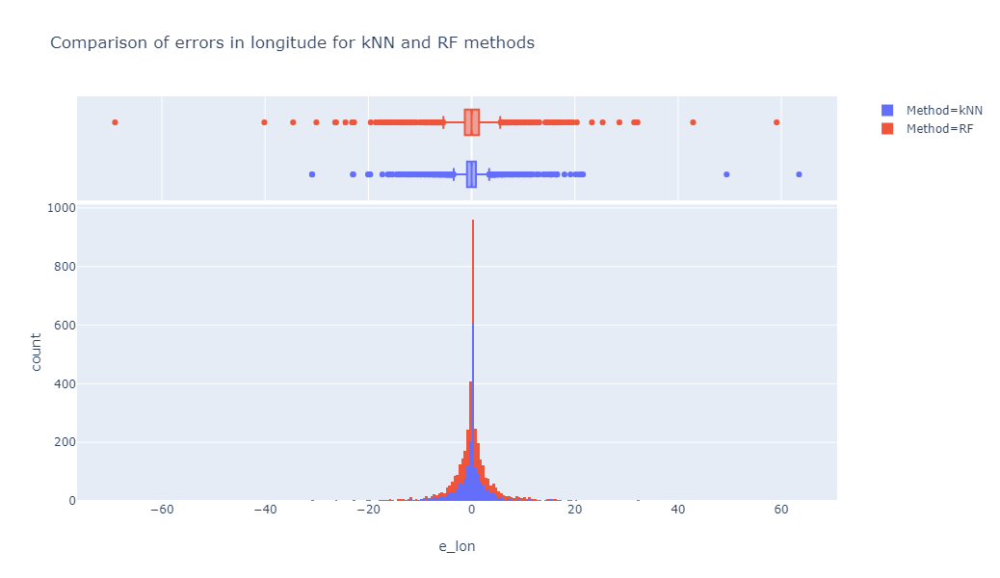

In [142]:
# Comparative histogram of errors in longitude for both methods ie (kNN vs RF)

fig = px.histogram(result, x="e_lon",color="Method",
                   marginal="box", # or violin, rug
                   hover_data=result.columns,
                   title="Comparison of errors in longitude for kNN and RF methods")
fig.show()

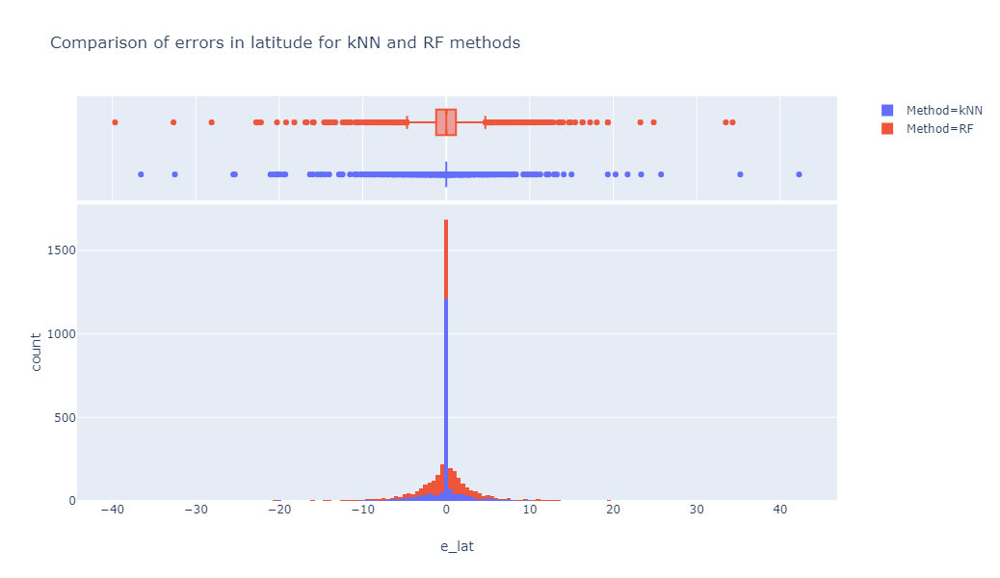

In [143]:
# Comparative histogram of errors in latitude for both methods ie (kNN vs RF)

fig = px.histogram(result, x="e_lat",color="Method",
                   marginal="box", # or violin, rug
                   hover_data=result.columns,
                   title="Comparison of errors in latitude for kNN and RF methods")
fig.show()

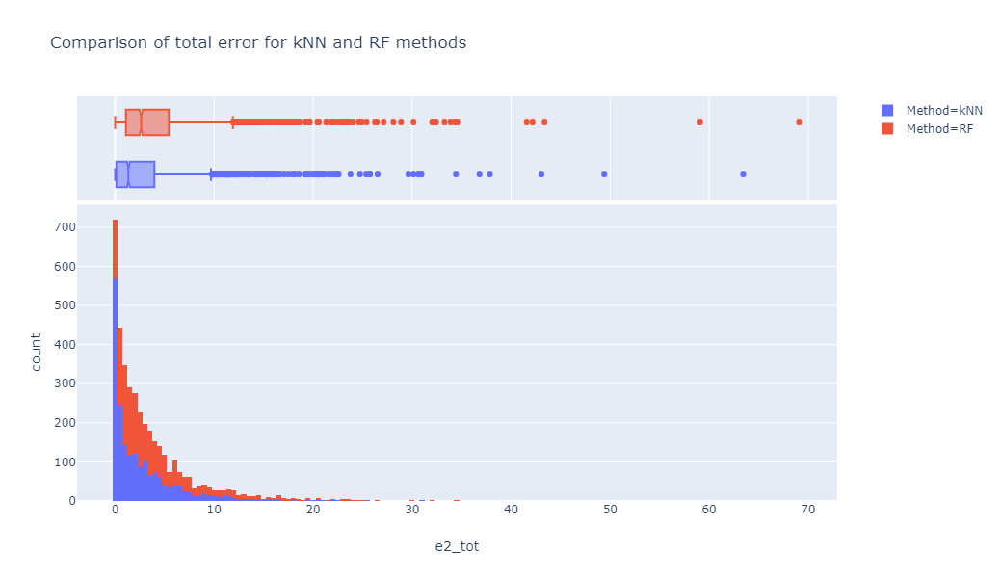

In [144]:
# Comparative histogram of total error for both methods ie (kNN vs RF)

fig = px.histogram(result, x="e2_tot",color="Method",
                   marginal="box", # or violin, rug
                   hover_data=result.columns,
                   title="Comparison of total error for kNN and RF methods")
fig.show()

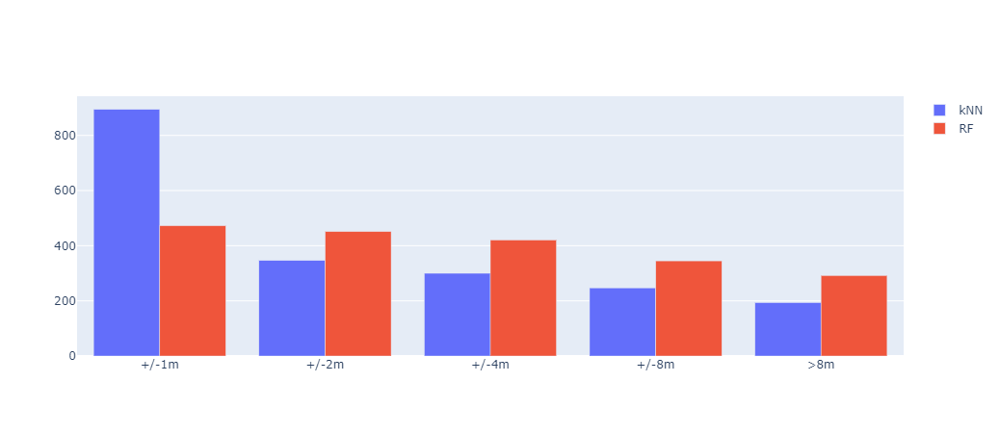

In [145]:
#kNN_errors["Type"].value_counts()
sortx = ['+/-1m','+/-2m','+/-4m','+/-8m','>8m']
fig = go.Figure(data=[
    go.Bar(name='kNN', x=np.unique(result['Type']), y=kNN_errors["Type"].value_counts()),
    go.Bar(name='RF' , x=np.unique(result['Type']), y=RF_errors["Type"].value_counts())
])
## Change the bar mode
fig.update_layout(barmode='group')
fig.show()

In [148]:
# Error type location by model

kNN_errors['y_val_lon'] = y_val_long
kNN_errors['y_val_lat'] = y_val_lat
kNN_errors['y_val_floor'] = y_val_floor

RF_errors['y_val_lon'] = y_val_long
RF_errors['y_val_lat'] = y_val_lat
RF_errors['y_val_floor'] = y_val_floor

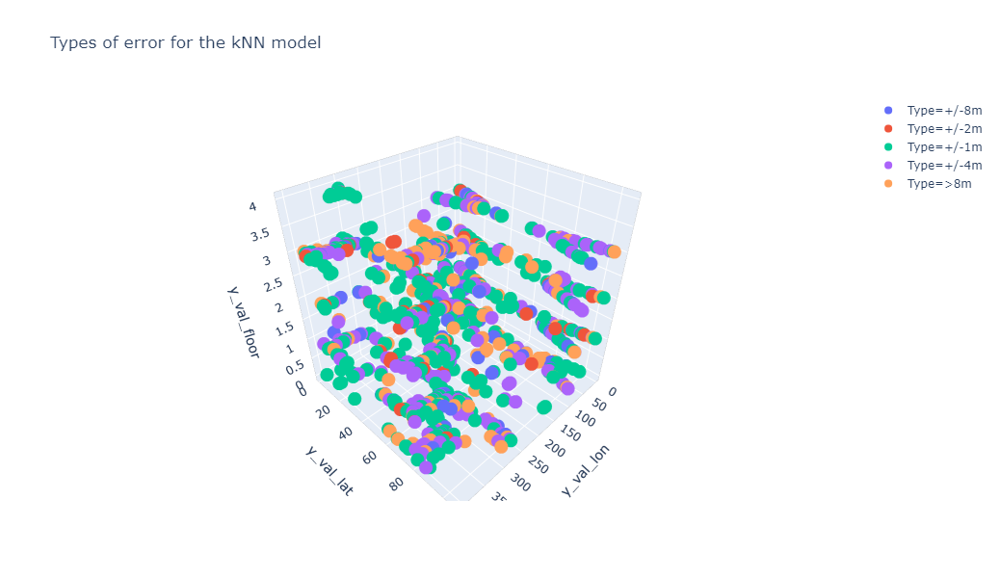

In [170]:
# Plotting the errors by location

import plotly.express as px

fig = px.scatter_3d(kNN_errors, x='y_val_lon', y='y_val_lat', z='y_val_floor',
              color='Type',title='Types of error for the kNN model')
fig.show()

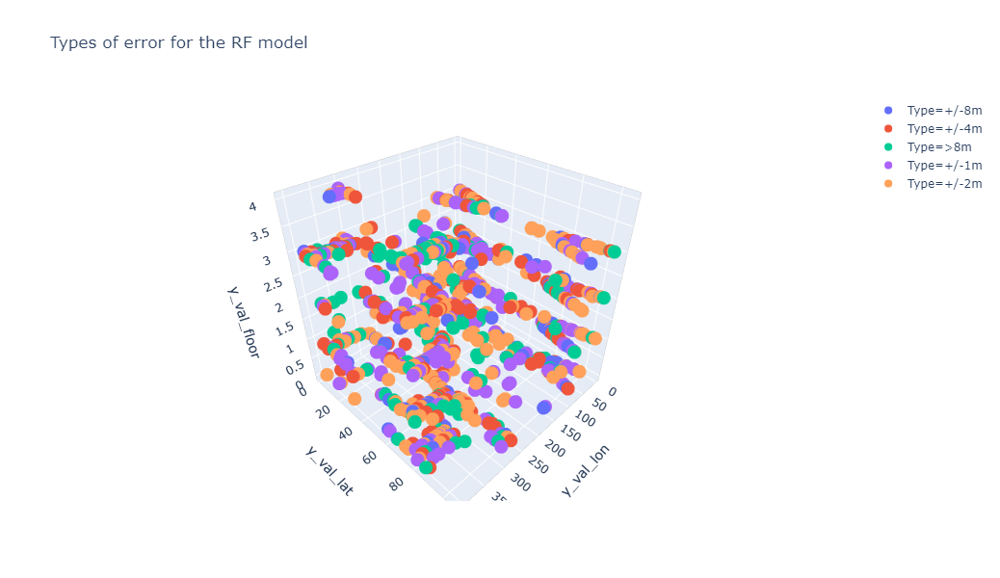

In [172]:
# Plotting the errors by location

import plotly.express as px

#d = {'+/-1m':'blue','+/-2m':'green','+/-4m':'yellow','+/-8m':'orange','>8m':'red'}
#kNN_errors['error'] = [d[c] for c in kNN_errors['Type']]

fig = px.scatter_3d(RF_errors, x='y_val_lon', y='y_val_lat', z='y_val_floor',
              color='Type',title='Types of error for the RF model')
fig.show()

In [222]:
# Now, let's see where are the differences between both models. As the big mistakes of the RF model a patternless we can't spect
# to see any pattern in the differences. Let's see if this assumption is true or not

# We set a new column in kNN_errors which will tel if both models have the same "binned" size of error.
kNN_errors['equal_type']=[x for x in np.where(kNN_errors['Type'] == RF_errors['Type'], 'blue', 'red')]

fig = px.scatter_3d(kNN_errors, x='y_val_lon', y='y_val_lat', z='y_val_floor',
             color='equal_type',
                    title='Location of differences in error types between both models')

fig.show()

In [232]:
# =============================================================================
#### Preprocessing - Tests data
# =============================================================================

In [233]:
## Load test data

filename_test = os.path.abspath(os.path.join(DataDir, 'testData.csv'))
testData = pd.read_csv(filename_test)

In [234]:
## Transformation (1. Change RSSI)

testData.iloc[:, 0:520] = testData.iloc[:, 0:520] + 105
testData.iloc[:, 0:520] = testData.iloc[:, 0:520].replace(to_replace = 205, value = 0)

In [235]:
testData_unique = testData.loc[:, X_train_normObs.columns]

In [236]:
## Scaling - Normalize rows

scaler_normObs_TEST = Normalizer(norm = 'l2', copy = True)
X_TEST_normObs = scaler_normObs_TEST.fit_transform(testData_unique)
X_TEST_normObs = pd.DataFrame(X_TEST_normObs, index = testData_unique.index, columns = testData_unique.columns)

In [237]:
# =============================================================================
#### Prediction
# =============================================================================

In [238]:
## Predict building

pred_TESTbuild_kNN = modelkNN_build.predict(X_TEST_normObs)
pred_TESTbuild_RF = modelkNN_build.predict(X_TEST_normObs)

In [239]:
## Compare prediction of building and create new df with building

X_TEST_normObs_casckNN = pd.concat([X_TEST_normObs, pd.Series(pred_TESTbuild_kNN)], axis = 1)
X_TEST_normObs_casckNN.rename(columns={0:'BUILDINGID'}, inplace=True)
X_TEST_normObs_casckNN.head()

X_TEST_normObs_cascRF = pd.concat([X_TEST_normObs, pd.Series(pred_TESTbuild_RF)], axis = 1)
X_TEST_normObs_cascRF.rename(columns={0:'BUILDINGID'}, inplace=True)
# --> both predictions for building are the same
X_TEST_normObs_cascRF.head()

,WAP001,WAP002,WAP003,WAP004,WAP005,WAP006,WAP007,WAP008,WAP009,WAP010,...,WAP512,WAP513,WAP514,WAP515,WAP516,WAP517,WAP518,WAP519,WAP520,BUILDINGID
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0


In [240]:
# X_TEST to be used to predict

#### Ignacio: Why you added the 'BUILDINGID' to your predictors to carry out a "cascade model" if your models are not using it?
X_TEST_normObs_casc = X_TEST_normObs_casckNN.copy()
X_TEST_normObs_casc.head()

,WAP001,WAP002,WAP003,WAP004,WAP005,WAP006,WAP007,WAP008,WAP009,WAP010,...,WAP512,WAP513,WAP514,WAP515,WAP516,WAP517,WAP518,WAP519,WAP520,BUILDINGID
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0


In [241]:
## Predict LONG and LAT

#### Ignacio: Here you are mixing things. You are going to use RF using the kNN prediction of 'BUILDING'!!! What's the reason of that?
#### Just because kNN and RF got the same results on prdicting 'BUILDINGID'. You should add an explanation and justification of your
#### approach.

#### Trying to add the kNN prediction of 'BUILDINGID' to use a "cascade" approach with both models. 
pred_TESTlong_kNN = modelkNN_long.predict(X_TEST_normObs_casc)
pred_TESTlong_RF = modelRF_long.predict(X_TEST_normObs_casc)

pred_TESTlat_kNN = modelkNN_lat.predict(X_TEST_normObs_casc)
pred_TESTlat_RF  = modelRF_lat.predict(X_TEST_normObs_casc)

pred_TESTfloor_kNN = modelkNN_floor.predict(X_TEST_normObs_casc)
pred_TESTfloor_RF = modelRF_floor.predict(X_TEST_normObs_casc)

In [242]:
## Create submission dataset

Prediction_TEST_kNN = pd.concat([pd.Series(pred_TESTlat_kNN), pd.Series(pred_TESTlong_kNN), pd.Series(pred_TESTfloor_kNN)], axis = 1)

Prediction_TEST_kNN.columns = ['LATITUDE', 'LONGITUDE', 'FLOOR']

In [243]:
## Create 3D-Scatterplot of prediction

#### Ignacio: Big problem here!!! Your model is reporting the longitude and Latitude transformed. You MUST undo the transformation
#### with the inverse of the rotation matrix before submmitting. You error metrics obtained for Longitude and Latitude, were luckly
#### because you trained you model to predict the "rotated" values, but not the "REAL" ones!
####
#### rotated = Rotation_matrix * current_lon_lat
#### real_values = (Rotation_matrix)^(-1)*predictions

fig = px.scatter_3d(Prediction_TEST_kNN, x='LONGITUDE', y='LATITUDE', z='FLOOR',
                    size_max = 10, opacity = 0.7)
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
plot(fig)

'temp-plot.html'

In [244]:
# =============================================================================
#### Postprocessing - Retransformation of prediction
# =============================================================================

In [246]:
## 1. Return to original scale
#### Ignacio, correct!
#### It's better to embeed this in a function which makes the transformation reverse transformation

#LONGITUDE
Prediction_TEST_kNN['LONGITUDE'] = Prediction_TEST_kNN['LONGITUDE'] - 2253200

#LATITUDE
Prediction_TEST_kNN['LATITUDE'] = Prediction_TEST_kNN['LATITUDE'] + 4311690

In [247]:
## 2. Transformation - Rotation of axis
# Set angel

#### Ignacio: Here, your approach is better just setting up the opposite angle you used for the rotation. Using the inverse matrix
#### will lead to rounding errors which can affect your predictions.
#### The same thing as before, try to embed the previous step and this in on finction which, given a set of predictions 
#### transforms back to the original dataset scale.

theta = np.radians(-27.5)

# Define transformation matrix
tM = np.matrix([[np.cos(theta), -np.sin(theta), 0],
                [np.sin(theta), np.cos(theta), 0],
                [0, 0, 1]])
tM

matrix([[ 0.88701083,  0.46174861,  0.        ],
        [-0.46174861,  0.88701083,  0.        ],
        [ 0.        ,  0.        ,  1.        ]])

In [248]:
# Select coordination columns

v_TEST = np.matrix(Prediction_TEST_kNN[['LONGITUDE', 'LATITUDE', 'FLOOR']])
v_TEST.shape
v_TEST = np.transpose(v_TEST)

In [249]:
# Rotation

tMv_TEST = tM * v_TEST

#### Ignacio: You are lucky, as the rotation matrix belongs to SO(3) and therefore transpose is the same as the inverse but in general,
#### the inverse of a matrix is not the transposed.

Prediction_TEST_kNN_It9_Output = pd.DataFrame(np.transpose(tMv_TEST), columns = ['LONGITUDE', 'LATITUDE', 'FLOOR'])
Prediction_TEST_kNN_It9_Output = pd.concat([Prediction_TEST_kNN_It9_Output['LATITUDE'], 
                                            Prediction_TEST_kNN_It9_Output['LONGITUDE'], 
                                            Prediction_TEST_kNN_It9_Output['FLOOR']], axis = 1)

In [250]:
## Create 3D-Scatterplot of final submission

fig2 = px.scatter_3d(Prediction_TEST_kNN_It9_Output, x='LONGITUDE', y='LATITUDE', z='FLOOR',
                     size_max = 10, opacity = 0.7)
fig2.update_layout(margin=dict(l=0, r=0, b=0, t=0))
plot(fig2)

'temp-plot.html'

In [251]:
## Export DataFrame to CSV

filename_export = os.path.abspath(os.path.join(SubmissionDir, 'Prediction_TEST_kNN_It9_Output_Paul.csv'))
Prediction_TEST_kNN_It9_Output.to_csv(filename_export, index = None, header = True)